# REGRESSION PROBLEM - USED CAR PRICE PREDICTION

## PRACTICES IN THIS NOTEBOOK

* End-to-End Data Science Solution
* Regression Modeling
* Exploratory Data Analysis (EDA)
* Feature Engineering and Selection
* XGBoost for Advanced Regression
* RandomizedSearchCV for Model Optimization
* Hyperparameter Tuning Techniques
* Data Visualization using Matplotlib, Seaborn, and Plotly

**Note**: Plotly outputs might encounter display issues on GitHub.

# Table of Contents

- **Introduction**
- **1. Problem Statement**
- **2. Data Understanding**
- **3. Import Libraries**
- **4. Load Data**
- **5. Exploratory Data Analysis - PART I**
  - 5.1. Overview
  - 5.1. Missing Values
  - 5.2. Duplication
  - 5.3. Datatypes
  - 5.4. Unique Values
  - 5.5. Outliers
  - 5.6. Statistics
- **6. Feature Engineering**
  - 6.1. Feature: Brand
    - Brand groups
    - Clustering Result
  - 6.2. Feature: Model
  - 6.3. Feature: Model Year
    - Add age as a feature
  - 6.4. Feature: Fuel Type
  - 6.5. Feature: Transmission
  - 6.6. Feature: Accident
  - 6.7. Feature: Clean Title
  - 6.8. Test Set Preprocessing
  - 6.9. Encoding
- **7. Exploratory Data Analysis - PART II**
  - 7.1. Milage vs Price
    - 7.1.1. Prices above 1M
    - Major Issue: Mistakes in Pricing
    - Solution Strategies
  - 7.2. Age vs Price
  - 7.3. Numerical Values vs Car Count
  - 7.4. Numerical Values vs Price
    - General Insights
    - Top 20 brands by car count
  - 7.6. Correlation Analysis
- **8. Modelling**
  - 8.1. Model Training
  - 8.2. Testing the Model
- **9. Conclusion**

# Introduction

In this notebook, we present a practical example of solving a regression problem.

To start, we explore the *Used Car Prices* dataset with the goal of predicting car prices. We initiate the process with a thorough Exploratory Data Analysis (EDA) to uncover important patterns, trends, and relationships within the data.

Please note, this dataset has been synthetically generated by the Kaggle community and may not accurately represent real-world data.

Methodology:

- Understanding the problem statement
- Data understanding
- Data preparation
- Modeling
- Evaluation
- Deployement/Submission

# 1. Problem Statement:

The objective of this project is to build a regression model to predict the price of used cars based on a variety of features, including the car’s brand, model, year, mileage, and other relevant attributes.

By developing an accurate predictive model, the goal is to provide valuable insights that can assist potential car buyers and sellers in estimating the market value of a vehicle based on its specifications. The end result is expected to be a robust car price prediction model capable of reliably estimating prices based on both the car's characteristics and its history. This model could be highly beneficial for car dealers, buyers, and sellers, enabling them to make well-informed pricing decisions with greater confidence.

# 2. Data Understanding:

This dataset serves as a valuable resource for automotive enthusiasts, potential buyers, and researchers interested in analyzing trends, making informed purchasing decisions, or conducting studies related to the automotive industry and consumer preferences. Whether you are a data analyst, car buyer, or researcher, this dataset offers a rich array of information to explore and analyze.

The dataset includes various features related to the car’s specifications and history, providing detailed insights into each vehicle. The target variable for the model is the **price**, representing the selling price of the car. Below is an overview of the key columns included in the dataset:

* **id**: A unique identifier for each car.
* **brand**: The manufacturer or brand of the car (e.g., Toyota, Honda).
* **model**: The specific model of the car.
* **model_year**: The year the car model was manufactured.
* **milage**: The number of miles the car has been driven.
* **fuel_type**: The type of fuel used by the car (e.g., gasoline, diesel, electric).
* **engine**: The engine capacity or power of the car.
* **transmission**: The type of transmission the car uses (e.g., manual, automatic).
* **ext_col**: The exterior color of the car.
* **int_col**: The interior color of the car.
* **accident**: A binary indicator (Yes/No) for whether the car has been involved in an accident.
* **clean_title**: A binary indicator for whether the car has a clean title, meaning it has not been significantly damaged or involved in severe incidents.
* **price**: The selling price of the car, which is the target variable for the prediction model.

This comprehensive dataset offers significant potential for deriving insights into used car pricing trends and patterns, making it an essential tool for anyone involved in the automotive industry or related research.

# 3. Import libraries

In [14]:
# Standard Library Imports
import warnings
import datetime

# Data Manipulation and Analysis
import pandas as pd
import numpy as np

# Data Profiling
from ydata_profiling import ProfileReport

# Visualization Libraries
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from IPython.display import display, HTML

# Machine Learning and Preprocessing
from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler, LabelEncoder
from sklearn.model_selection import KFold, cross_val_score, train_test_split, RandomizedSearchCV, GridSearchCV, cross_val_predict
from sklearn.ensemble import RandomForestRegressor
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
import xgboost as xgb

# Inline magic for plotting
%matplotlib inline

# Suppress warnings
warnings.simplefilter("ignore")

# 4. Load Data

In [16]:
df_main_train = pd.read_csv("train.csv")
df_main_test = pd.read_csv("test.csv")

df = df_main_train.copy()
test = df_main_test.copy()

print("Datasets are loaded.")
print("Shape of train set: {}".format(df.shape))
print("Shape of test set: {}".format(test.shape))
print("\nColumns of train set: {}".format(df.columns.tolist()))
print("\nColumns of test set: {}".format(test.columns.tolist()))

Datasets are loaded.
Shape of train set: (188533, 13)
Shape of test set: (125690, 12)

Columns of train set: ['id', 'brand', 'model', 'model_year', 'milage', 'fuel_type', 'engine', 'transmission', 'ext_col', 'int_col', 'accident', 'clean_title', 'price']

Columns of test set: ['id', 'brand', 'model', 'model_year', 'milage', 'fuel_type', 'engine', 'transmission', 'ext_col', 'int_col', 'accident', 'clean_title']


# 5. Explatory Data Analysis - PART I

For EDA, following steps will be followed:

* Dataframe overview
* Check Missing values
* Check Duplicates
* Check data type
* Check the number of unique values of each column
* Check outliers
* Check statistics of the dataset

## 5.1. Overview

In [20]:
df.head()

,id,brand,model,model_year,milage,fuel_type,engine,transmission,ext_col,int_col,accident,clean_title,price
0,0,MINI,Cooper S Base,2007,213000,Gasoline,172.0HP 1.6L 4 Cylinder Engine Gasoline Fuel,A/T,Yellow,Gray,None reported,Yes,4200
1,1,Lincoln,LS V8,2002,143250,Gasoline,252.0HP 3.9L 8 Cylinder Engine Gasoline Fuel,A/T,Silver,Beige,At least 1 accident or damage reported,Yes,4999
2,2,Chevrolet,Silverado 2500 LT,2002,136731,E85 Flex Fuel,320.0HP 5.3L 8 Cylinder Engine Flex Fuel Capab...,A/T,Blue,Gray,None reported,Yes,13900
3,3,Genesis,G90 5.0 Ultimate,2017,19500,Gasoline,420.0HP 5.0L 8 Cylinder Engine Gasoline Fuel,Transmission w/Dual Shift Mode,Black,Black,None reported,Yes,45000
4,4,Mercedes-Benz,Metris Base,2021,7388,Gasoline,208.0HP 2.0L 4 Cylinder Engine Gasoline Fuel,7-Speed A/T,Black,Beige,None reported,Yes,97500


## 5.1. Missing Values

In [22]:
df.isnull().sum()

id                  0
brand               0
model               0
model_year          0
milage              0
fuel_type        5083
engine              0
transmission        0
ext_col             0
int_col             0
accident         2452
clean_title     21419
price               0
dtype: int64

## 5.2. Duplication

In [24]:
df.duplicated().sum()

0

## 5.3. Datatypes

In [26]:
df.dtypes

id               int64
brand           object
model           object
model_year       int64
milage           int64
fuel_type       object
engine          object
transmission    object
ext_col         object
int_col         object
accident        object
clean_title     object
price            int64
dtype: object

## 5.4. Unique Values

In [28]:
df.nunique()

id              188533
brand               57
model             1897
model_year          34
milage            6651
fuel_type            7
engine            1117
transmission        52
ext_col            319
int_col            156
accident             2
clean_title          1
price             1569
dtype: int64

## 5.5. Outliers

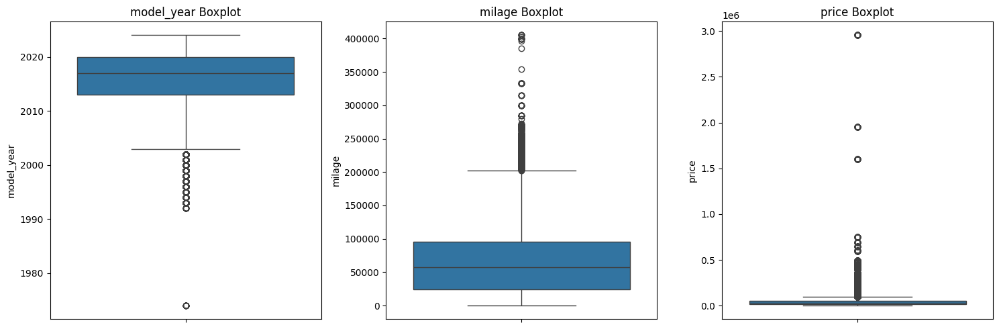

In [30]:
numerical_cols = ['model_year', 'milage', 'price']
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for i, col in enumerate(numerical_cols):
    sns.boxplot(ax=axes[i], data=df, y=col)
    axes[i].set_title(f'{col} Boxplot')

plt.tight_layout()
plt.show()

## 5.6. Statistics

In [32]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,188533.0,94266.000000,54424.933488,0.0,47133.0,94266.0,141399.0,188532.0
model_year,188533.0,2015.829998,5.660967,1974.0,2013.0,2017.0,2020.0,2024.0
milage,188533.0,65705.295174,49798.158076,100.0,24115.0,57785.0,95400.0,405000.0
price,188533.0,43878.016178,78819.522254,2000.0,17000.0,30825.0,49900.0,2954083.0


In [33]:
profile = ProfileReport(df); profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 6. Feature Engineering 

## 6.1. Feature: brand

* Generate clusters of the brands based on their price.
* Visually check the groups and name the categories.

### Brand groups

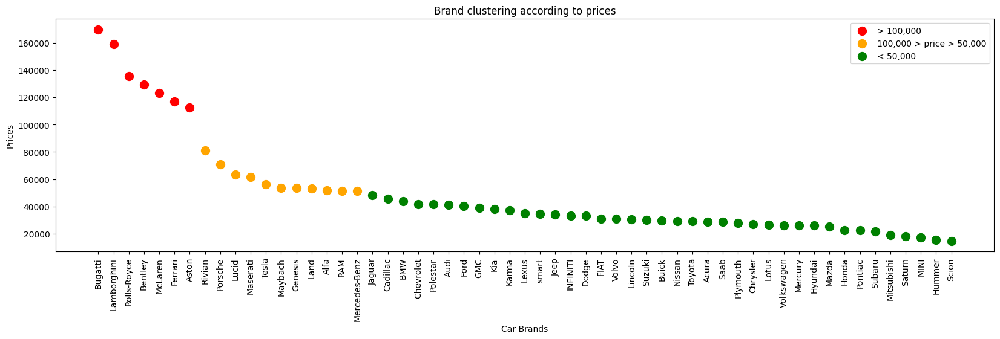

In [38]:
brands = df.groupby("brand")[["price"]].mean().sort_values("price",ascending=False).reset_index().round(2)
x_brands = brands.iloc[:,:].values
brand = x_brands[:, 0]
prices = x_brands[:, 1].astype(float)  # Convert prices to floats for numerical operations

# Create the figure
plt.figure(figsize=(20, 5))

# Plot for prices > 100,000 (red)
plt.scatter(brand[prices > 100000], prices[prices > 100000], color='red', s=100, label='> 100,000')

# Plot for 100,000 > prices > 50,000 (orange)
plt.scatter(brand[(prices <= 100000) & (prices > 50000)], prices[(prices <= 100000) & (prices > 50000)],
            color='orange', s=100, label='100,000 > price > 50,000')

# Plot for prices < 50,000 (green)
plt.scatter(brand[prices <= 50000], prices[prices <= 50000], color='green', s=100, label='< 50,000')

# Rotate the x-axis labels (brand names)
plt.xticks(rotation=90)
plt.xlabel('Car Brands')
plt.ylabel('Prices')
plt.title('Brand clustering according to prices')
plt.legend()
plt.show()

### Clustering Result:



Three distinct groups of brands can be identified based on average prices. This brand categorization (brand_category) will be merged with the original DataFrame for further analysis.

In [41]:
brands["brand_category"]=np.nan
brands.loc[brands['price'] > 100000, 'brand_category'] = 'A'
brands.loc[(brands['price'] > 50000) & (brands['price'] <= 100000), 'brand_category'] = 'B'
brands.loc[(brands['price'] > 0) & (brands['price'] <= 50000), 'brand_category'] = 'C'
brands.drop("price", axis=1, inplace=True)

In [42]:
df = pd.merge(df, brands, on=["brand"], how="left")

# check the missing values
df.brand_category.isna().sum()

0

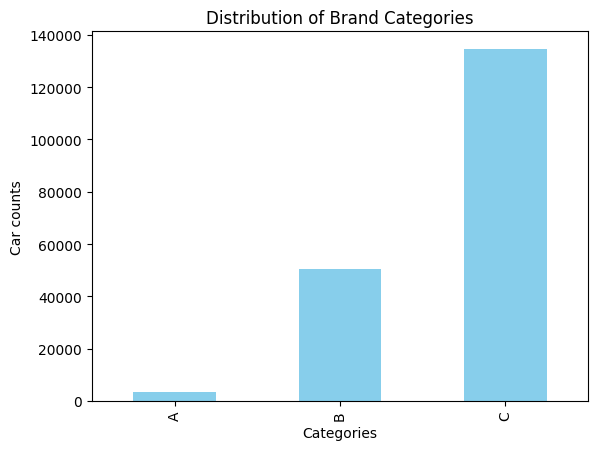

In [43]:
# Visualize car brands based on car counts

brands_value_counts = df.brand_category.value_counts().sort_values(ascending=True)
brands_value_counts.plot(kind="bar", color="skyblue")
plt.xlabel("Categories")
plt.ylabel("Car counts")
plt.title("Distribution of Brand Categories")
plt.show()

## 6.2. Feature: model

In [45]:
df.model.head(15).tolist()

['Cooper S Base',
 'LS V8',
 'Silverado 2500 LT',
 'G90 5.0 Ultimate',
 'Metris Base',
 'A6 2.0T Sport',
 'A8 L 3.0T',
 'Silverado 1500 1LZ',
 'F-150 XLT',
 'M4 Base',
 'Camaro 1LT',
 'Model S P100D',
 'Escalade ESV Platinum',
 'S4 3.0T Premium Plus',
 'Rover Range Rover P530 SE SWB']

When examining the feature, it becomes clear that the first word of each row provides a strong indication of the model. It may be beneficial to extract the first word into a separate column named "**model_detail**" and subsequently group the models based on this new column.

However, there are two common cases that need special handling:

* **Case 1: AMG Models**  
    When "AMG" is included in the model name, the model name starts with "AMG." In such cases, the new column should return the words that follow "AMG." For example:
    - AMG C 63 S --> C 63
    - AMG GLS 63 4MATIC --> GLS 63
    - AMG CLA 45 Base 4MATIC --> CLA 45

* **Case 2: Tesla Models (Containing 'Model')**  
    If the model name contains the word "Model," one additional word is needed to fully describe the model, as "Model" alone is insufficient. For example:
    - Model S P100D --> Model S

In [47]:
def model_detail_model_update(row):
    words = row["model"].split()
    if words[0]=="Model":
        return " ".join(words[:2])
    return row["model_detail"]

def amg_separator(text):
    model = text.split(" ")
    count=0
    for i in range(len(model)):
        if model[i].isnumeric():
            return model[i-1]+" "+model[i]
            count+=1
    if count==0:
        return model[0]

df["model_detail"]=np.nan
df["model_detail"] = df.apply(model_detail_model_update, axis=1)
df["model_detail"] = df.model.apply(lambda x: amg_separator(x) if x[:3]=="AMG" else x.split(" ")[0])

In [48]:
# check missing values

df.model_detail.isna().sum()

0

## 6.3. Feature: model_year

In [50]:
def car_age(df):
    age = datetime.datetime.now().year-df.model_year
    if age==0:
        return "unused"
    elif age<=3:
        return "new"
    elif age<=6:
        return "fairly_new"
    elif age<=9:
        return "medium"
    elif age<=12:
        return "old"
    elif age<=20:
        return "very_old"
    else:
        return "very_very_old"
    return df["car_age_group"]

df["car_age_group"] = df.apply(car_age, axis=1)

### Add age as a feature

In [52]:
df["age"] = datetime.datetime.now().year-df["model_year"]

## 6.4. Feature: fuel_type

The data for the `fuel_type` feature is not clean. Therefore, a dominant fuel type will be assigned based on the specific combination of brand, model, and engine. This predefined list will be used to correct the original `fuel_type` values. Additionally, the value 'Electric' will be added for electric engines where applicable.

In [55]:
fuel_type_count = df.groupby(['brand', 'model', 'engine', 'fuel_type']).size().reset_index(name='count')
dominant_fuel_type = fuel_type_count.sort_values('count', ascending=False).drop_duplicates(subset=['brand', 'model', 'engine'])
dominant_fuel_type["all"] = dominant_fuel_type.brand + dominant_fuel_type.model + dominant_fuel_type.engine
df["all"] = df.brand + df.model + df.engine
dominant_fuel_type = dominant_fuel_type[["all", "fuel_type"]].reset_index()
df = pd.merge(df, dominant_fuel_type, on=["all"], how="left")
df.drop(["fuel_type_x", "index"], axis=1, inplace=True)
df.rename(columns={"fuel_type_y": "fuel_type"}, inplace=True)
df.loc[(df['fuel_type'].isna()) & df['engine'].str.contains("lectr"), 'fuel_type'] = "Electric"
df.loc[df.brand=="Tesla", "fuel_type"]="Electric"
df.fuel_type.fillna("–",inplace=True)

In [56]:
df.columns

Index(['id', 'brand', 'model', 'model_year', 'milage', 'engine',
       'transmission', 'ext_col', 'int_col', 'accident', 'clean_title',
       'price', 'brand_category', 'model_detail', 'car_age_group', 'age',
       'all', 'fuel_type'],
      dtype='object')

##### 6.3. Feature: engine

In [58]:
df.engine.head(10).tolist()

['172.0HP 1.6L 4 Cylinder Engine Gasoline Fuel',
 '252.0HP 3.9L 8 Cylinder Engine Gasoline Fuel',
 '320.0HP 5.3L 8 Cylinder Engine Flex Fuel Capability',
 '420.0HP 5.0L 8 Cylinder Engine Gasoline Fuel',
 '208.0HP 2.0L 4 Cylinder Engine Gasoline Fuel',
 '252.0HP 2.0L 4 Cylinder Engine Gasoline Fuel',
 '333.0HP 3.0L V6 Cylinder Engine Gasoline Fuel',
 '355.0HP 5.3L 8 Cylinder Engine Flex Fuel Capability',
 '2.7L V6 24V PDI DOHC Twin Turbo',
 '425.0HP 3.0L Straight 6 Cylinder Engine Gasoline Fuel']

There are 1117 unique engine values. It contains **Horse Power**, **Cylinder Volume**. So these values needs to be separated into different columns.


There are 1117 unique engine values. It contains **Horse Power**, **Cylinder Volume**. So these values needs to be separated into different columns.

**New feature: hp**

First, look for "HP" value at the end of first word.
View missing values

In [60]:
df["hp"] = df["engine"].apply(lambda x: x.split(" ")[0] if x.split(" ")[0][-2:]=="HP" else np.nan)
df.hp.isna().sum()

33259

Initially 33259 values are missing. So;

* generate a new dataframe, hp_temp and convert data type into integer.
* calculate mean hp value for each model in hp_temp2
* transfer mean hp value to original df via merge
* View missing values

In [62]:
df["hp"] = df[df["hp"].notnull()].hp.apply(lambda x: x.split(".")[0])
hp_temp = df[df["hp"].notnull()]
hp_temp["hp"] = hp_temp["hp"].astype(int)
hp_temp2 = hp_temp.groupby("model")[["hp"]].mean().reset_index()
df = pd.merge(df, hp_temp2, on="model", how = "left")
df.loc[df['hp_x'].isna(), 'hp_x'] = df['hp_y']
df.rename(columns={'hp_x': 'hp'}, inplace=True)
df.drop("hp_y", axis=1 , inplace=True)
df.hp.isna().sum()

438

Now missing values have been reduced from 33259, down to 438.

* now, generate a new dataframe, hp_temp3, to calculate mean value for **brand**.
* View missing values

In [64]:
hp_temp3 = df[df.hp.notna()]
hp_temp3["hp"] = hp_temp3.hp.astype(float)
hp_temp4 = hp_temp3.groupby("brand")[["hp"]].mean().reset_index()
df = pd.merge(df, hp_temp4, on="brand", how = "left")
df.loc[df['hp_x'].isna(), 'hp_x'] = df['hp_y']
df.rename(columns={'hp_x': 'hp'}, inplace=True)
df.drop("hp_y", axis=1 , inplace=True)
df.hp.isna().sum()

7

Now missing values have been reduced from 438, down to 7.

* now, generate a new dataframe, hp_temp4, to calculate mean value for **brand_category**.
* View missing values

In [66]:
df.brand.str.contains("Bugatti").sum()

7

In [67]:
hp_temp5 = df[df.hp.notna()]
hp_temp5["hp"] = hp_temp5.hp.astype(float)
hp_temp6 = hp_temp5.groupby("brand_category")[["hp"]].mean().reset_index()
df = pd.merge(df, hp_temp6, on="brand_category", how = "left")
df.loc[df['hp_x'].isna(), 'hp_x'] = df['hp_y']
df.rename(columns={'hp_x': 'hp'}, inplace=True)
df.drop("hp_y", axis=1 , inplace=True)
df.hp = df.hp.astype(float)
df.hp.isna().sum()

0

**New Feature: cylinder (volume)**

* volume information can be either in first or in second word in engine values.

    - '172.0HP *1.6L* 4 Cylinder Engine Gasoline Fuel'
    - '*2.7L* V6 24V PDI DOHC Twin Turbo'



* First, check this information
* View missing values

In [70]:
df.engine.head(10).tolist()

['172.0HP 1.6L 4 Cylinder Engine Gasoline Fuel',
 '252.0HP 3.9L 8 Cylinder Engine Gasoline Fuel',
 '320.0HP 5.3L 8 Cylinder Engine Flex Fuel Capability',
 '420.0HP 5.0L 8 Cylinder Engine Gasoline Fuel',
 '208.0HP 2.0L 4 Cylinder Engine Gasoline Fuel',
 '252.0HP 2.0L 4 Cylinder Engine Gasoline Fuel',
 '333.0HP 3.0L V6 Cylinder Engine Gasoline Fuel',
 '355.0HP 5.3L 8 Cylinder Engine Flex Fuel Capability',
 '2.7L V6 24V PDI DOHC Twin Turbo',
 '425.0HP 3.0L Straight 6 Cylinder Engine Gasoline Fuel']

In [71]:
df["cylinder"] = df["engine"].apply(lambda x: x.split(" ")[1] if len(x.split(" ")) > 1 and x.split(" ")[1][-1:] == "L"
                                    else (x.split(" ")[0] if len(x.split(" ")) > 1 and x.split(" ")[0][-1:] == "L" 
                                          else (x if x[-1:]=="L" else np.nan)))
df.cylinder.isna().sum()

14214

The rule worked great. So there is now 14214 values are missing.

* Another improvement point would be the looking for the word "Liter"
    - 2.0 Liter DOHC Turbo
    - 3.0 Liter Twin Turbo
    - 4.0 Liter
* Filter the values with word "Liter" and extract volume information.
* View missing values

In [73]:
df.engine.str.contains("Liter").sum()

7444

In [74]:
for index, value in df.engine.items():
    if "Liter" in value:
        df.at[index, 'cylinder'] = value.split(" ")[0]
df.cylinder.isna().sum()

6770

* Missing values have been reduced from 14214, down to 6770.

* For the rest of missing values, lets use mean value for the rest of volumes.

In [76]:
df['cylinder'] = df['cylinder'].str.replace('L', '', regex=False)
df['cylinder'] = df['cylinder'].astype(float)
df.cylinder.fillna(df[df["cylinder"].notna()].cylinder.mean(), inplace=True)
df.cylinder.isna().sum()

0

## 6.5. Feature: transmission 

* Tranmission has 52 distinct values with no missing values.
* 52 distinct values will be reduced down to 4 groups:
    * Manual
    * Automatic
    * Dual
    * others (-)

In [79]:
df["transmission_type"]= np.nan
df.loc[df["transmission"].str.contains("M"), "transmission_type"]="Manual"
df.loc[df["transmission"].str.contains("A"), "transmission_type"]="Automatic"
df.loc[df["transmission"].str.contains("Dual"), "transmission_type"]="Dual"
df.loc[df["transmission"].str.contains("CVT"), "transmission_type"]="Automatic"
df.loc[df["transmission"].str.contains("Overdrive"), "transmission_type"]="Automatic"
df.loc[df["transmission"].str.contains("F"), "transmission_type"]="Automatic"
df.loc[df["transmission"].str.contains("2"), "transmission_type"]="Automatic"
df.loc[df["transmission"].str.contains("Single-Speed Fixed Gear"), "transmission_type"]="Automatic"
df.loc[df["transmission"].str.contains("6-Speed"), "transmission_type"]="Manual"
df.loc[df["transmission"].str.contains("7-Speed"), "transmission_type"]="Automatic"
df.transmission_type.fillna("Others", inplace=True)
df.transmission_type.isna().sum()

0

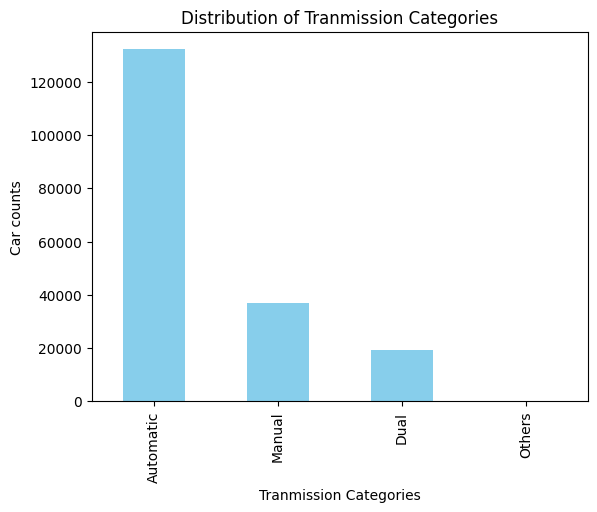

In [80]:
tranmission_value_counts = df.transmission_type.value_counts().sort_values(ascending=False)
tranmission_value_counts.plot(kind="bar", color="skyblue")
plt.xlabel("Tranmission Categories")
plt.ylabel("Car counts")
plt.title("Distribution of Tranmission Categories")
plt.show()

## 6.6. Feature: accident

* There are 2452 missing values in accident column.
* Milage can give a strong prediction on accident probability.
* To carry on with calculations, accidents_temp df will be generated

In [83]:
accidents_temp = df[df.accident.notna()]
accidents_temp.accident = accidents_temp.accident.replace("None reported", 0)
accidents_temp.accident = accidents_temp.accident.replace("At least 1 accident or damage reported", 1)
accidents_temp.accident = accidents_temp.accident.astype(int)

In [84]:
accidents_temp["milage_group"] = (accidents_temp["milage"] // 1000 + 1)*1000
df["milage_group"] = (df["milage"] // 1000 + 1)*1000

In [85]:
acc_grouped = accidents_temp.groupby('milage_group').agg(total_accidents=('accident', 'sum'),
                                         car_count=('milage', 'size')).reset_index()
acc_grouped["cumulative_total_accidents"] = acc_grouped["total_accidents"].cumsum()
acc_grouped["cumulative_car_count"] = acc_grouped["car_count"].cumsum()
acc_grouped["mean_accidents"] = acc_grouped["cumulative_total_accidents"] / acc_grouped["cumulative_car_count"]
acc_grouped[['milage_group', 'car_count', 'cumulative_total_accidents', "mean_accidents"]]

,milage_group,car_count,cumulative_total_accidents,mean_accidents
0,1000,1589,77,0.048458
1,2000,2708,181,0.042122
2,3000,2805,284,0.039989
3,4000,1550,333,0.038488
4,5000,2570,423,0.037694
...,...,...,...,...
263,355000,1,41559,0.223367
264,386000,1,41559,0.223366
265,396000,1,41560,0.223370
266,400000,14,41565,0.223380


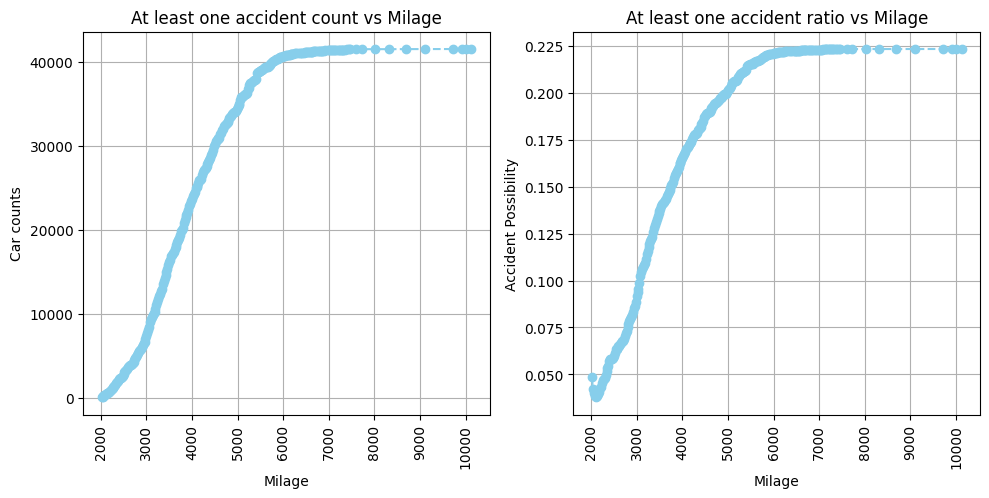

In [86]:
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].plot(acc_grouped.milage_group, acc_grouped.cumulative_total_accidents, marker="o",
             linestyle="--", color="skyblue", label="Line")
axes[0].set_title("At least one accident count vs Milage")
axes[0].set_xlabel("Milage")
axes[0].set_ylabel("Car counts")
axes[0].grid(True)
axes[0].set_xticklabels(acc_grouped.milage_group, rotation=90)  # Rotate x-ticks
axes[1].plot(acc_grouped.milage_group, acc_grouped.mean_accidents, marker="o",
             linestyle="--", color="skyblue", label="Line")
axes[1].set_title("At least one accident ratio vs Milage")
axes[1].set_xlabel("Milage")
axes[1].set_ylabel("Accident Possibility")
axes[1].grid(True)
axes[1].set_xticklabels(acc_grouped.milage_group, rotation=90)  # Rotate x-ticks
plt.tight_layout()
plt.show()

In [87]:
acc_grouped = acc_grouped[['milage_group', "mean_accidents"]]
df = pd.merge(df, acc_grouped, on="milage_group", how="left")

In [88]:
df.accident.isna().sum()

2452

In [89]:
df.head()

,id,brand,model,model_year,milage,engine,transmission,ext_col,int_col,accident,...,model_detail,car_age_group,age,all,fuel_type,hp,cylinder,transmission_type,milage_group,mean_accidents
0,0,MINI,Cooper S Base,2007,213000,172.0HP 1.6L 4 Cylinder Engine Gasoline Fuel,A/T,Yellow,Gray,None reported,...,Cooper,very_old,17,MINICooper S Base172.0HP 1.6L 4 Cylinder Engin...,Gasoline,172.0,1.6,Automatic,214000,0.222125
1,1,Lincoln,LS V8,2002,143250,252.0HP 3.9L 8 Cylinder Engine Gasoline Fuel,A/T,Silver,Beige,At least 1 accident or damage reported,...,LS,very_very_old,22,LincolnLS V8252.0HP 3.9L 8 Cylinder Engine Gas...,Gasoline,252.0,3.9,Automatic,144000,0.198526
2,2,Chevrolet,Silverado 2500 LT,2002,136731,320.0HP 5.3L 8 Cylinder Engine Flex Fuel Capab...,A/T,Blue,Gray,None reported,...,Silverado,very_very_old,22,ChevroletSilverado 2500 LT320.0HP 5.3L 8 Cylin...,E85 Flex Fuel,320.0,5.3,Automatic,137000,0.194843
3,3,Genesis,G90 5.0 Ultimate,2017,19500,420.0HP 5.0L 8 Cylinder Engine Gasoline Fuel,Transmission w/Dual Shift Mode,Black,Black,None reported,...,G90,medium,7,GenesisG90 5.0 Ultimate420.0HP 5.0L 8 Cylinder...,Gasoline,420.0,5.0,Dual,20000,0.056869
4,4,Mercedes-Benz,Metris Base,2021,7388,208.0HP 2.0L 4 Cylinder Engine Gasoline Fuel,7-Speed A/T,Black,Beige,None reported,...,Metris,new,3,Mercedes-BenzMetris Base208.0HP 2.0L 4 Cylinde...,Gasoline,208.0,2.0,Automatic,8000,0.039481


In [90]:
df.loc[df['accident'].isna(), 'accident'] = df['mean_accidents']
df.accident.fillna(df.mean_accidents.mean(), inplace=True)
df.accident.isna().sum()

0

In [91]:
df['accident'] = df['accident'].replace({
    'At least 1 accident or damage reported': 1,
    'None reported': 0
})

df['accident'] = df['accident'].astype(float)

## 6.7. Feature: clean_title

* 88.6% of cars have clean_title. Rest of the values are missing.
* clean_title can be directly corelated with accidents.
* %11.4 of values are questionable.
* So it's better to drop the column.

In [94]:
df.clean_title.isna().sum()

21419

In [95]:
(1-(df.clean_title.notna().sum()/len(df))).round(3)*100

11.4

In [96]:
#df.drop("clean_title", axis=1, inplace=True)

In [97]:
df.clean_title.replace("Yes", 1)
df.clean_title.fillna(0, inplace=True)

## 6.8 Test set preprocessing

In [99]:
test.columns

Index(['id', 'brand', 'model', 'model_year', 'milage', 'fuel_type', 'engine',
       'transmission', 'ext_col', 'int_col', 'accident', 'clean_title'],
      dtype='object')

**Test set preprocessing:**

- **'id'**: leave it for submission.
- **'brand'**: merge with "brands" to add brand_category
- **'model'**: add model_detail
- **'model_year'**: add car_age_group
- **'milage'**: no action
- **'fuel_type'**: generate "all" column. merge with dominant_fuel_type on="all", add "Electric", fillna("-")
- **'engine'**: Filter "HP" in first word of engine, merge with hp_temp2, hp_temp4, convert to float. Filter "L" for cylinder volume values. Then filter "Liter". Fill rest with mean value of train df.
- **'transmission'**: filter transmission values for transmission_type column
- **'ext_col'**: no action
- **'int_col'**: no action
- **'accident'**: add milage_group, merge with acc_grouped, fillna with mean accidents.
- **'clean_title'**: drop the column

In [101]:
# brand
test = pd.merge(test, brands, on=["brand"], how="left")
# model
test["model_detail"]=np.nan
test["model_detail"] = test.apply(model_detail_model_update, axis=1)
test["model_detail"] = test.model.apply(lambda x: amg_separator(x) if x[:3]=="AMG" else x.split(" ")[0])
# model year
test["car_age_group"] = test.apply(car_age, axis=1)

In [102]:
# fuel type
test["all"] = test.brand + test.model + test.engine
test = pd.merge(test, dominant_fuel_type, on=["all"], how="left")
test.drop(["fuel_type_x", "index","all"], axis=1, inplace=True)
test.rename(columns={"fuel_type_y": "fuel_type"}, inplace=True)
test.loc[(test['fuel_type'].isna()) & test['engine'].str.contains("lectr"), 'fuel_type'] = "Electric"
test.loc[test.brand=="Tesla", "fuel_type"]="Electric"
test.fuel_type.fillna("–",inplace=True)

In [103]:
# engine: hp:
test["hp"] = test["engine"].apply(lambda x: x.split(" ")[0] if x.split(" ")[0][-2:]=="HP" else np.nan)
test["hp"] = test[test["hp"].notnull()].hp.apply(lambda x: x.split(".")[0])
test = pd.merge(test, hp_temp2, on="model", how = "left")
test.loc[test['hp_x'].isna(), 'hp_x'] = test['hp_y']
test.rename(columns={'hp_x': 'hp'}, inplace=True)
test.drop("hp_y", axis=1 , inplace=True)
test = pd.merge(test, hp_temp4, on="brand", how = "left")
test.loc[test['hp_x'].isna(), 'hp_x'] = test['hp_y']
test.rename(columns={'hp_x': 'hp'}, inplace=True)
test.drop("hp_y", axis=1 , inplace=True)
test = pd.merge(test, hp_temp6, on="brand_category", how = "left")
test.loc[test['hp_x'].isna(), 'hp_x'] = test['hp_y']
test.rename(columns={'hp_x': 'hp'}, inplace=True)
test.drop("hp_y", axis=1 , inplace=True)
test["hp"] = test["hp"].astype(float)

In [104]:
# engine: cylinder:
test["cylinder"] = test["engine"].apply(lambda x: x.split(" ")[1] if len(x.split(" ")) > 1 and x.split(" ")[1][-1:] == "L"
                                else (x.split(" ")[0] if len(x.split(" ")) > 1 and x.split(" ")[0][-1:] == "L" 
                                      else (x if x[-1:]=="L" else np.nan)))
for index, value in test.engine.items():
    if "Liter" in value:
        test.at[index, 'cylinder'] = value.split(" ")[0]
test['cylinder'] = test['cylinder'].str.replace('L', '', regex=False)
test['cylinder'] = test['cylinder'].astype(float)
test.cylinder.fillna(df[df["cylinder"].notna()].cylinder.mean(), inplace=True)
# transmission:
test["transmission_type"]= np.nan
test.loc[test["transmission"].str.contains("M"), "transmission_type"]="Manual"
test.loc[test["transmission"].str.contains("A"), "transmission_type"]="Automatic"
test.loc[test["transmission"].str.contains("Dual"), "transmission_type"]="Dual"
test.loc[test["transmission"].str.contains("CVT"), "transmission_type"]="Automatic"
test.loc[test["transmission"].str.contains("Overdrive"), "transmission_type"]="Automatic"
test.loc[test["transmission"].str.contains("F"), "transmission_type"]="Automatic"
test.loc[test["transmission"].str.contains("2"), "transmission_type"]="Automatic"
test.loc[test["transmission"].str.contains("Single-Speed Fixed Gear"), "transmission_type"]="Automatic"
test.loc[test["transmission"].str.contains("6-Speed"), "transmission_type"]="Manual"
test.loc[test["transmission"].str.contains("7-Speed"), "transmission_type"]="Automatic"
test.transmission_type.fillna("Others", inplace=True)
# accidents:
test["milage_group"] = (test["milage"] // 1000 + 1)*1000
test = pd.merge(test, acc_grouped, on="milage_group", how="left")
test.loc[test['accident'].isna(), 'accident'] = test['mean_accidents']
test.accident.fillna(df.mean_accidents.mean(), inplace=True)
test.mean_accidents.fillna(df.mean_accidents.mean(), inplace=True)
test['accident'] = test['accident'].replace({
    'At least 1 accident or damage reported': 1,
    'None reported': 0})
test['accident'] = test['accident'].astype(float)

#age
test["age"] = datetime.datetime.now().year-test["model_year"]

# clean_title:
test.clean_title.replace("Yes", 1)
test.clean_title.fillna(0, inplace=True)
#test.drop("clean_title", axis=1, inplace=True)

## 6.9. Encoding

In [106]:
df.dtypes

id                     int64
brand                 object
model                 object
model_year             int64
milage                 int64
engine                object
transmission          object
ext_col               object
int_col               object
accident             float64
clean_title           object
price                  int64
brand_category        object
model_detail          object
car_age_group         object
age                    int64
all                   object
fuel_type             object
hp                   float64
cylinder             float64
transmission_type     object
milage_group           int64
mean_accidents       float64
dtype: object

In [107]:
# Target encoding for 'brand'
brand_target_mean = df.groupby('brand')['price'].mean()
df['brand_encoded'] = df['brand'].map(brand_target_mean)

# Target encoding for 'model_detail' 
model_detail_target_mean = df.groupby('model_detail')['price'].mean()
df['model_detail_encoded'] = df['model_detail'].map(model_detail_target_mean)

In [108]:
df.model_detail_encoded.dtypes

dtype('float64')

In [109]:
df.columns

Index(['id', 'brand', 'model', 'model_year', 'milage', 'engine',
       'transmission', 'ext_col', 'int_col', 'accident', 'clean_title',
       'price', 'brand_category', 'model_detail', 'car_age_group', 'age',
       'all', 'fuel_type', 'hp', 'cylinder', 'transmission_type',
       'milage_group', 'mean_accidents', 'brand_encoded',
       'model_detail_encoded'],
      dtype='object')

In [110]:
cat_columns = df[['brand_category', 'car_age_group', 'fuel_type', 'transmission_type']]
dummies = pd.get_dummies(cat_columns,drop_first=True).astype(float)

In [111]:
y = df.price
X_ = df[["model_year", "milage", "accident", "hp", "cylinder", "brand_encoded", "model_detail_encoded", "age"]]
X = pd.concat([X_, dummies], axis=1)
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 188533 entries, 0 to 188532
Data columns (total 26 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   model_year                   188533 non-null  int64  
 1   milage                       188533 non-null  int64  
 2   accident                     188533 non-null  float64
 3   hp                           188533 non-null  float64
 4   cylinder                     188533 non-null  float64
 5   brand_encoded                188533 non-null  float64
 6   model_detail_encoded         188533 non-null  float64
 7   age                          188533 non-null  int64  
 8   brand_category_B             188533 non-null  float64
 9   brand_category_C             188533 non-null  float64
 10  car_age_group_medium         188533 non-null  float64
 11  car_age_group_new            188533 non-null  float64
 12  car_age_group_old            188533 non-null  float64
 13 

# 7. Explatory Data Analysis - PART II

## 7.1. Milage vs Price

Graph between milage and price can tell a story. Let's start by plotting it and see what could be done next.

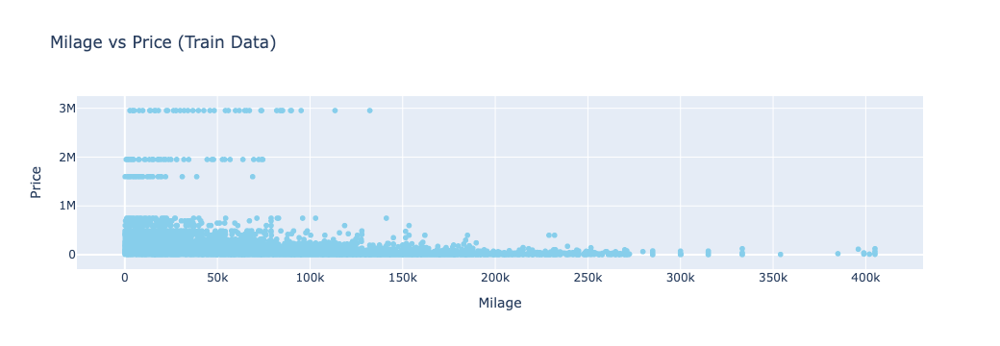

In [114]:
# Scatter plot for Milage vs Price

fig = px.scatter(df, 
                 x='milage', 
                 y='price', 
                 title='Milage vs Price (Train Data)',
                 labels={'milage': 'Milage', 'price': 'Price'})

fig.update_traces(marker=dict(color='skyblue'))
fig.show()

There are 3 parts in the plot. Over 2M, over 1M and below 1M.

Over 2M is very similiar with Over 1M. The model will be evaluated according to RMSE due to the Kaggle Competition, therefore these values are significant. So handling these two groups are important.

For the group, below 1M, there seems to be a relationship as increasing milage decreases the price, but it is not very clear.

There is a noticable point in 3 high price points. Let's plot it.

### 7.1.1. Prices above 1M

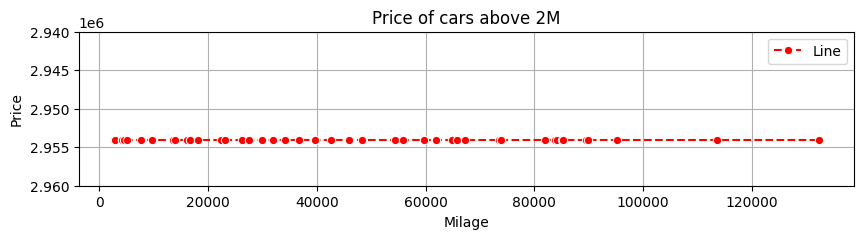

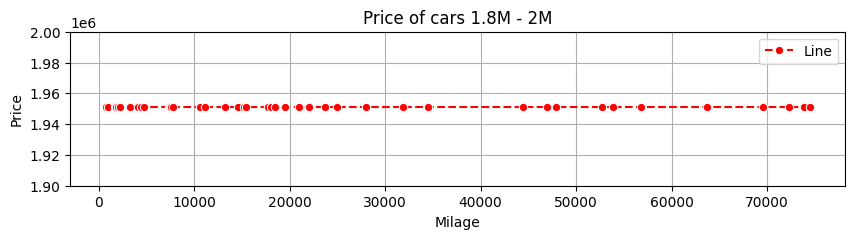

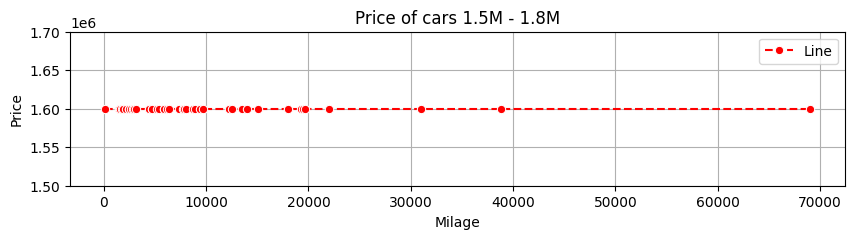

In [117]:
high_prices_level1 = df[df["price"]>2500000]

plt.figure(figsize=(10,2))
sns.lineplot(data= high_prices_level1, x=high_prices_level1.milage, y=high_prices_level1.price, marker = "o", linestyle='--', color='r', label='Line')
plt.ylim(2960000,2940000)
plt.title("Price of cars above 2M")
plt.xlabel("Milage")
plt.ylabel("Price")
plt.grid(True)

high_prices_level2 = df[(df["price"]>1800000) & (df["price"]<2500000)]

plt.figure(figsize=(10,2))
sns.lineplot(data= high_prices_level2, x=high_prices_level2.milage, y=high_prices_level2.price, marker = "o", linestyle='--', color='r', label='Line')
plt.ylim(1900000,2000000)
plt.title("Price of cars 1.8M - 2M")
plt.xlabel("Milage")
plt.ylabel("Price")
plt.grid(True)

high_prices_level3 = df[(df["price"]>1500000) & (df["price"]<1800000)]

plt.figure(figsize=(10,2))
sns.lineplot(data= high_prices_level3, x=high_prices_level3.milage, y=high_prices_level3.price, marker = "o", linestyle='--', color='r', label='Line')
plt.ylim(1500000,1700000)
plt.title("Price of cars 1.5M - 1.8M")
plt.xlabel("Milage")
plt.ylabel("Price")
plt.grid(True)

plt.show()


### MAJOR ISSUE: MISTAKES IN PRICING

Cars above 1.5M price has 3 groups and price variance in the groups are zero! It doesn't seem very realistic. As it can be seen in the plot, this error pattern could be systematically introduced into a dataset by applying 3 fixed values to  vehicles.

	• The brands of the cars include luxury or high-performance manufacturers such as Porsche, Rolls-Royce, and Lamborghini.
	• The cars are either very recent models or from premium lineups.
	• Despite their high values, these entries have been misclassified due to possible mistakes in the way prices were entered or formatted, such as misplaced commas or incorrect scaling.

### SOLUTION STRATEGIES

* The first approach will be based on the nature of the problem. The dataset is sourced from a Kaggle competition, and it’s highly likely that some of the price values have been deliberately mislabelled. Both the training and test sets likely share the same pattern of errors. Prices exceeding 1.5M are significantly higher than the average for specific brands. Since the evaluation metric is Root Mean Square Error (RMSE), which heavily penalizes larger errors, we need a strategy to identify and understand any patterns in the mistakes, if such patterns exist.

------ For further action in this matter, this issue will be handled in a different notebook ------

* Secondly, we shall carry on with accepting prices as handed over, and train the data without additional corrections.

* Lastly, if this was not a Kaggle competition, prices must be corrected by regression techniques.




## 7.2. Age vs Price

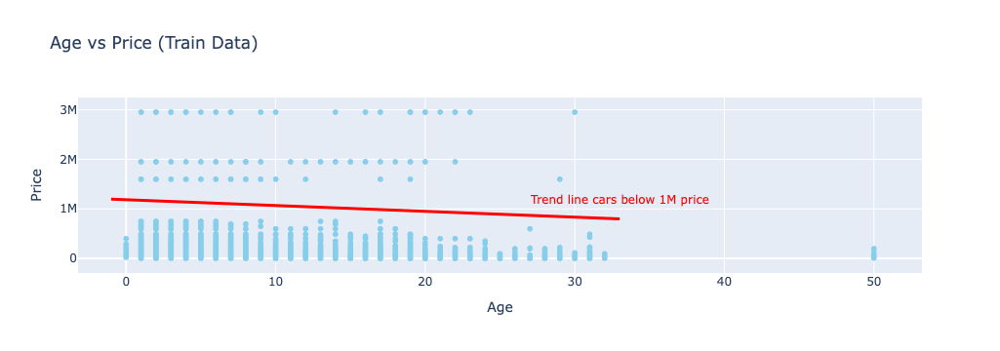

In [121]:
# Scatter plot for Milage vs Price

fig = px.scatter(df, 
                 x='age', 
                 y='price', 
                 title='Age vs Price (Train Data)',
                 labels={'age': 'Age', 'price': 'Price'})

fig.add_shape(type='line',
              x0=-1, y0=1200000, x1=33, y1=800000,
              line=dict(color='red', width=3))

fig.add_annotation(
    x=33,
    y=1000000,
    text="Trend line cars below 1M price",
    showarrow=False,
    font=dict(color='red', size=12),
    xanchor='center',
    yanchor='bottom'
)

fig.update_traces(marker=dict(color='skyblue'))
fig.show()

* Hereby we can see a trend line for lower priced cars as when age increases, price decreases.
* Outliers can be seen in the plot. Cars at age 50 has a price range of 10K - 197K.
* Prices exceeding 1.5 has no trend. They have fixed values. 

## 7.3. Numerical Values vs Car Count

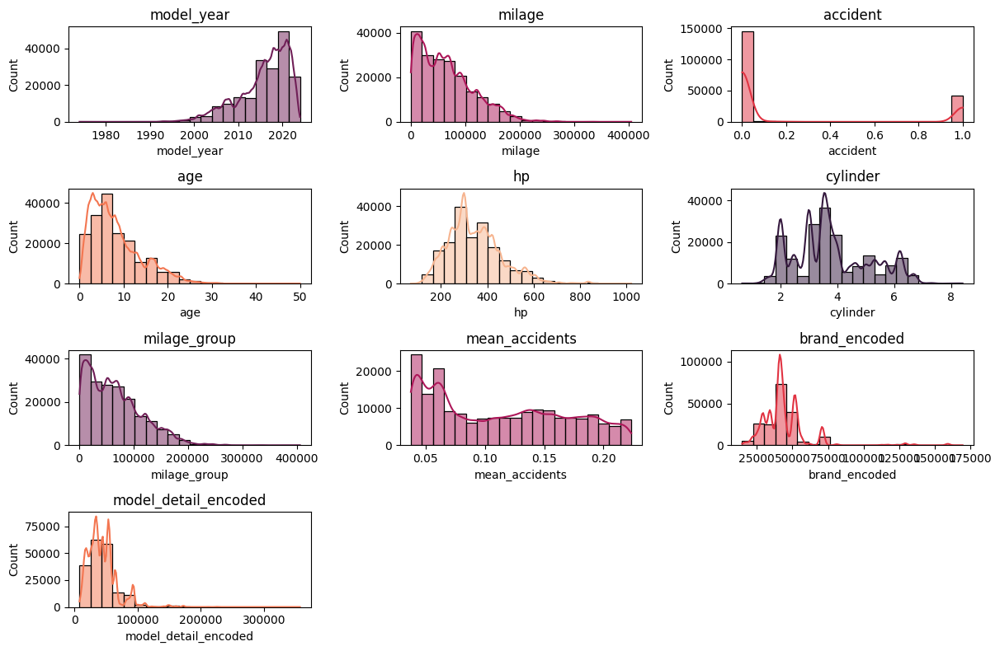

In [124]:
numerical_columns = df.select_dtypes(include=["number"]).drop("id", axis=1)

plt.figure(figsize=(12, 8))

for i, feature in enumerate(numerical_columns.drop("price", axis=1), 1):
    plt.subplot((len(numerical_columns.columns) + 2) // 3, 3, i) 
    sns.histplot(data=df, x=feature, bins=20, kde=True,
                color=sns.color_palette("rocket")[i % len(sns.color_palette("rocket"))])
    plt.title(feature)

plt.tight_layout()
plt.show()

## 7.4. Numerical Values vs Price

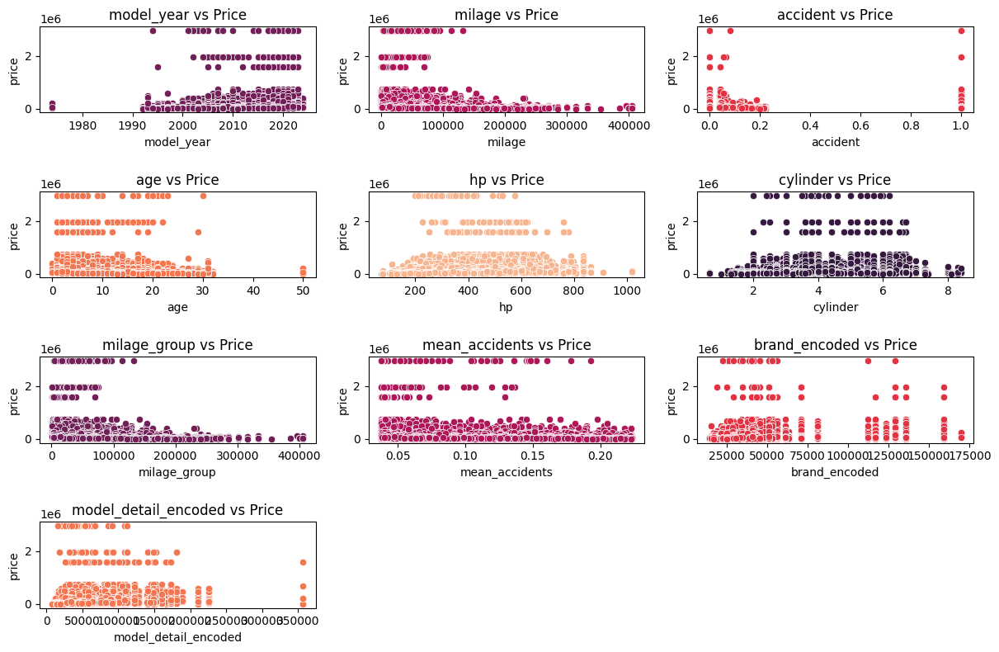

In [126]:
# Now plot relationships between each feature and price using scatter plots
plt.figure(figsize=(12, 8))

for i, feature in enumerate(numerical_columns.drop("price", axis=1), 1):
    plt.subplot((len(numerical_columns.columns) + 2) // 3, 3, i)
    sns.scatterplot(data=df, x=feature, y='price', palette="rocket",
                   color=sns.color_palette("rocket")[i % len(sns.color_palette("rocket"))])
    plt.title(f"{feature} vs Price")

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the scatter plots
plt.show()

1. `model_year` vs `Price`:
- Newer model years (from around 2010 onwards) tend to have higher prices.
- There is a noticeable group of cars priced around 0 despite having newer model years, which could indicate outliers or data points for older, cheaper models that have been re-registered or entered into the dataset with errors.

2. `milage` vs `Price`:
- Cars with higher mileage tend to have lower prices, which makes sense as cars with more usage generally depreciate in value.
- There's a sharp drop in price for cars with over 200,000 miles, suggesting that buyers tend to devalue cars significantly once they reach a certain mileage threshold.

3. `accident` vs `Price`:
- Cars that have been in accidents (indicated by values closer to 1) generally have lower prices compared to cars with no reported accidents (value 0).
- This indicates that accidents negatively impact a car’s value.

4. `age` vs `Price`:
- The older the car (higher age), the lower its price tends to be, which is expected due to depreciation.
- There seems to be a cluster of older cars that maintain higher prices, possibly indicating vintage or classic cars that retain value despite their age.

5. `hp` vs `Price`:
- There is a slight positive correlation between horsepower (`hp`) and price, but the relationship is not as strong as with other features.
- Cars with very high horsepower (above 500) tend to have prices spread across the range, suggesting that factors other than just horsepower influence the price.

6. `cylinder` vs `Price`:
- Cars with higher cylinder counts (typically more powerful engines) seem to generally have higher prices.
- Most of the cars with 8 cylinders maintain a high price, whereas cars with fewer cylinders (like 4-cylinder engines) span a wider price range.

7. `milage_group` vs `Price`:
- This is similar to the earlier mileage plot. Higher mileage groups correspond to lower prices, indicating depreciation as the mileage increases.

8. `mean_accidents` vs `Price`:
- Cars with higher average accident rates have lower prices, supporting the trend seen in the "accident vs Price" plot.

### General Insights:
- **Depreciation factors** such as mileage, age, and accident history have a strong negative correlation with car price, as expected.
- **Engine-related features** (horsepower and cylinder count) show some positive correlation with price, though other factors might also play a significant role in determining price.
- **Outliers** are present** in almost all plots (e.g., newer model years with very low prices or cars with many accidents but still maintaining a high price), suggesting that there may be some other contextual or qualitative factors affecting price (such as condition, special features, or brand).

## 7.5. Top 20 brands by car count

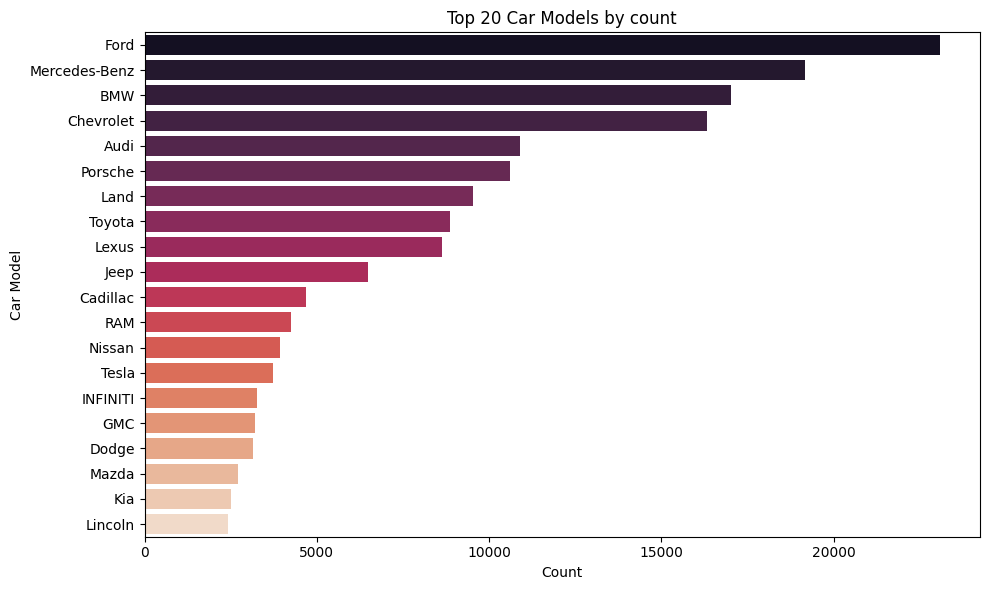

In [129]:
n = 20  # Number of top car models to plot
top_car_models = df['brand'].value_counts().head(n)
plt.figure(figsize=(10, 6))
sns.barplot(x=top_car_models.values, y=top_car_models.index, palette="rocket")
plt.title(f'Top {n} Car Models by count')
plt.xlabel('Count')
plt.ylabel('Car Model')
plt.tight_layout()
plt.show()

In [130]:
top_brands = top_car_models.index.tolist()
len(df[df["brand"].isin(top_brands)].index)/len(df)

0.872356563572425

Top 20 car brands consists of 87.2% of total.

## 7.6. Correlation Analysis

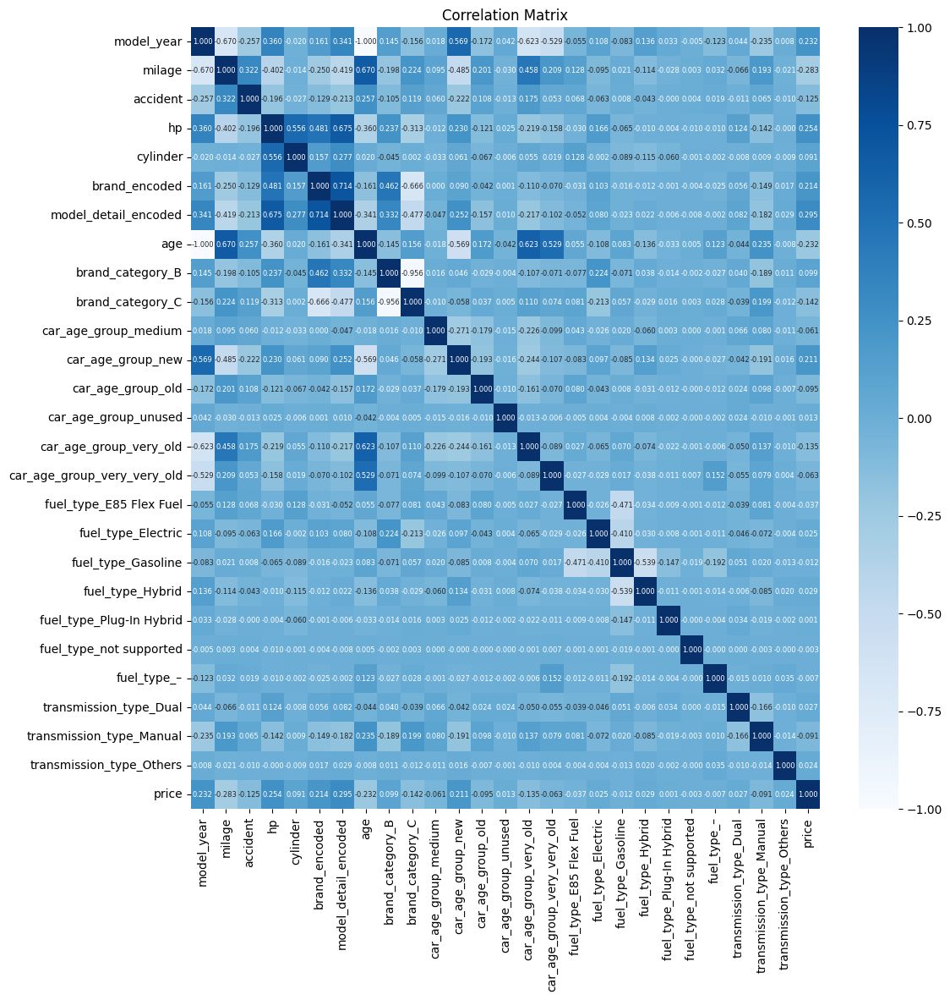

In [133]:
# Correlation matrix

train_data = pd.concat([X, y], axis=1)
correlation_matrix = train_data.corr()
target_correlation = correlation_matrix['price']

plt.figure(figsize=(12, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='Blues', fmt=".3f", annot_kws={"size": 6})
plt.title('Correlation Matrix')
plt.show()

# 8. Modelling

## 8.1. Model Training

In [136]:
# Step 1: Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 2: Initialize XGBoost Regressor
xg_reg = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

# Step 3: Set up hyperparameter grid for RandomizedSearchCV (regularization parameters)
# Note: Number of parameters have been limited with 1 per each in order to reduce process time.

param_grid = {
    'n_estimators': [100], 
    'learning_rate': [0.1],       
    'max_depth': [3],                  
    'subsample': [1.0],                 
    'colsample_bytree': [0.8],          
    'gamma': [0.2],                       
    'reg_alpha': [0],                      
    'reg_lambda': [1],                   
}

# Step 4: RandomizedSearchCV with cross-validation on the training set
xg_random = RandomizedSearchCV(estimator=xg_reg, param_distributions=param_grid,
                               n_iter=50, cv=5, verbose=2, random_state=42, n_jobs=-1)

# Step 5: Fit the model on the training data
xg_random.fit(X_train, y_train)

# Step 6: Best parameters from RandomizedSearchCV
print("Best parameters found: ", xg_random.best_params_)

# Step 7: Evaluate the model on the test set
best_xg_reg = xg_random.best_estimator_
y_pred = best_xg_reg.predict(X_test)

# Step 8: Calculate performance on the test set (e.g., RMSE)
rmse_test = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'RMSE on the test set: {rmse_test}')

# Step 9: Cross-validation on the training set
cv_scores = cross_val_score(best_xg_reg, X_train, y_train, cv=5, scoring='neg_mean_squared_error')
mse_scores = -cv_scores
rmse_cv_scores = np.sqrt(mse_scores)

print(f'Cross-validated RMSE scores on training set: {rmse_cv_scores}')
print(f'Average RMSE from cross-validation: {rmse_cv_scores.mean()}')

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Best parameters found:  {'subsample': 1.0, 'reg_lambda': 1, 'reg_alpha': 0, 'n_estimators': 100, 'max_depth': 3, 'learning_rate': 0.1, 'gamma': 0.2, 'colsample_bytree': 0.8}
RMSE on the test set: 68193.99566146816
Cross-validated RMSE scores on training set: [65551.80778757 81276.05598491 68573.26350916 73769.54037278
 79599.90827722]
Average RMSE from cross-validation: 73754.11518632865


In [137]:
predictions = best_xg_reg.predict(X_test)

In [138]:
# Root Mean Square Error

np.sqrt(mean_squared_error(y_test, predictions))

68193.99566146816

## 8.2. Testing the model

In [140]:
test.dtypes

id                     int64
brand                 object
model                 object
model_year             int64
milage                 int64
engine                object
transmission          object
ext_col               object
int_col               object
accident             float64
clean_title           object
brand_category        object
model_detail          object
car_age_group         object
fuel_type             object
hp                   float64
cylinder             float64
transmission_type     object
milage_group           int64
mean_accidents       float64
age                    int64
dtype: object

In [141]:
brand_target_mean_dict = brand_target_mean.to_dict()
model_detail_target_mean_dict = model_detail_target_mean.to_dict()

# for test
global_mean_price = df['price'].mean()

# target encoding
test['brand_encoded'] = test['brand'].map(brand_target_mean_dict).fillna(global_mean_price)
test['model_detail_encoded'] = test['model_detail'].map(model_detail_target_mean_dict).fillna(global_mean_price)

In [142]:
cat_columns = test[['brand_category', 'car_age_group', 'fuel_type', 'transmission_type', 'age']]
dummies = pd.get_dummies(cat_columns,drop_first=True).astype(float)

In [143]:
X_ = test[["model_year", "milage", "accident", "hp", "cylinder", "brand_encoded", "model_detail_encoded" ]]
X = pd.concat([X_, dummies], axis=1)
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 125690 entries, 0 to 125689
Data columns (total 26 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   model_year                   125690 non-null  int64  
 1   milage                       125690 non-null  int64  
 2   accident                     125690 non-null  float64
 3   hp                           125690 non-null  float64
 4   cylinder                     125690 non-null  float64
 5   brand_encoded                125690 non-null  float64
 6   model_detail_encoded         125690 non-null  float64
 7   age                          125690 non-null  float64
 8   brand_category_B             125690 non-null  float64
 9   brand_category_C             125690 non-null  float64
 10  car_age_group_medium         125690 non-null  float64
 11  car_age_group_new            125690 non-null  float64
 12  car_age_group_old            125690 non-null  float64
 13 

In [144]:
predictions = best_xg_reg.predict(X)

In [145]:
ids = test["id"]
predictions_df = pd.DataFrame({"id":ids, "price": predictions})
predictions_df.set_index('id', inplace=True)

# 9. Conclusion

Saving predictions to a CSV file.

In [148]:
# predictions_df.to_csv("predictions.csv")
print("Done!")

Done!
